In [1]:
import os
if 'examples' in os.getcwd(): os.chdir('../')
print(os.getcwd())

/home/bernie40916/Nas/home/Project/DJtransGAN-dg-pipeline


In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
import torch
import matplotlib.pyplot as plt
import torchaudio

from pipeline.config  import settings
from pipeline.feature import estimate_feature, keynum_to_keylabel
from pipeline.feature import segment_structure, estimate_sources, estimate_stem, get_separator
from pipeline.utils   import load_audio, find_nearest, find_index
from pipeline.utils   import wave_visualize, audio_visualize
from pipeline.segment import get_segment

### Feature Extraction

In [4]:
audio_path = os.path.join(settings.AUDIO_DIR, '1135856.wav')
audio      = load_audio(audio_path)
separator  = get_separator(n_gpu=0)

In [5]:
feature         = estimate_feature(audio_path)
sig, bpm, beat, downbeat = feature['beat']
key_num, style  = feature['key']
boundary, label = feature['structure']
source          = estimate_sources(estimate_stem(audio_path, separator))

### Visualize

In [20]:
print('key: ', keynum_to_keylabel((key_num, style)))
print('bpm: ', f'{bpm:.4}')
print('sig: ', f'{sig[0]}/{sig[1]}')

key:  C minor
bpm:  89.99
sig:  4/4


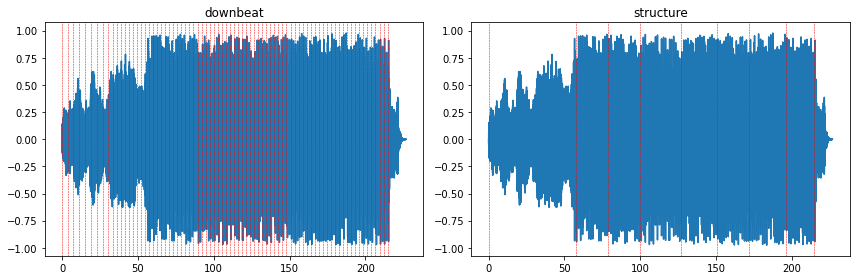

source:  ['drums', 'bass', 'other']
stucture:  ['0.03', '57.33', '78.66', '99.99', '126.66', '150.66', '171.99', '195.99', '214.66']


In [21]:
fig, axs = plt.subplots(1, 2, figsize=(12, 4))

wave_visualize(audio, axs[0], title='downbeat' , timestamps=downbeat)
wave_visualize(audio, axs[1], title='structure', timestamps=boundary)

plt.tight_layout()
plt.show()

audio_visualize(audio)

print('source: ', source)
print('stucture: ', [f'{b:.2f}' for b in boundary])